In [1]:
!pip install watermark pycaret --quiet
%load_ext watermark
%watermark -a 'NavinKumarMNK' -v -p polars,plotly,catboost,lightgbm,xgboost,pycaret

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Author: NavinKumarMNK

Python implementation: CPython
Python version       : 3.10.10
IPython version      : 8.12.0

polars  : 0.17.5
plotly  : 5.14.1
catboost: 1.1.1
lightgbm: 3.3.2
xgboost : 1.7.5
pycaret : 3.0.2



In [2]:
import polars as pl
import pandas as pd
import os
import gc
import catboost as cb
import lightgbm as lgb
import xgboost as xgb
import plotly.express as px
from tqdm import tqdm
from sklearn.metrics import f1_score
from sklearn.model_selection import GroupKFold, KFold
import warnings
import optuna
from sklearn.metrics import make_scorer, f1_score
from pycaret.classification import *
warnings.filterwarnings('ignore')

In [3]:
import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/kaggle/input/game-play-features/features/data_ques_4.parquet
/kaggle/input/game-play-features/features/data_ques_12.parquet
/kaggle/input/game-play-features/features/data_ques_14.parquet
/kaggle/input/game-play-features/features/data_ques_5.parquet
/kaggle/input/game-play-features/features/data_ques_13.parquet
/kaggle/input/game-play-features/features/data_ques_6.parquet
/kaggle/input/game-play-features/features/data_ques_15.parquet
/kaggle/input/game-play-features/features/data_ques_9.parquet
/kaggle/input/game-play-features/features/data_ques_11.parquet
/kaggle/input/game-play-features/features/data_ques_2.parquet
/kaggle/input/game-play-features/features/data_ques_1.parquet
/kaggle/input/game-play-features/features/data_ques_17.parquet
/kaggle/input/game-play-features/features/data_ques_8.parquet
/kaggle/input/game-play-features/features/data_ques_3.parquet
/kaggle/input/game-play-features/features/data_ques_7.parquet
/kaggle/input/game-play-features/features/data_ques_10.parquet
/

## **Training**

In [4]:
CATBOOST_CATS = ['year', 'month', 'day', 'hour', "is_fullscreen", "is_hq", "is_music"]

## **Questions**

In [5]:
def trail(q):
    print("-"*50)
    print(f"Question {q}")
    print("-"*50)
    if q <= 3:
        grp = '0-4'
    elif q <= 13:
        grp = '5-12'
    elif q <= 22:
        grp = '13-22'

    main_df = pd.read_parquet(f"/kaggle/input/game-play-features/features/data_ques_{q}.parquet")
    main_df = main_df.drop("group", axis=1)

    for i in range(1, q):
        main_df = main_df.drop(f'ques_{i}', axis=1)

    a = main_df['target'].value_counts().to_dict()

    print(main_df.shape)   
    exp = setup(main_df.iloc[:, 1:], target='target', session_id=q,
                fold_strategy=GroupKFold(n_splits=5), fold_groups=main_df['session_id'],
               preprocess=False, categorical_features=CATBOOST_CATS,
               train_size=0.99)

    remove_metric('f1')
    remove_metric('Accuracy')
    remove_metric('AUC')
    remove_metric('Recall')
    remove_metric('Precision')
    remove_metric('Kappa')
    remove_metric('MCC')

    add_metric('f1', 'F1', f1_score, average="macro", greater_is_better=True)

    catboost = create_model('catboost', cat_features=CATBOOST_CATS,
                                    loss_function="Logloss",
                                    scale_pos_weight=a[0]/a[1]
                                    )

    tuned_top_model = tune_model(catboost, optimize="F1", tuner_verbose=False,
                                early_stopping=True, early_stopping_max_iters=50)
    
    # Finalize and save the best model
    best_model = finalize_model(tuned_top_model)
    best_threshold = optimize_threshold(best_model, optimize="F1") 
    print(best_threshold)
    
    save_model(best_model, f'best_model_ques_{q}')
    plot_model(best_model, plot='confusion_matrix', use_train_data=True)
    plot_model(best_model, plot='feature_all', use_train_data=True)
    plot_model(best_model, plot='parameter', use_train_data=True)
    plot_model(best_model, plot='class_report', use_train_data=True)
    plot_model(best_model, plot='auc', use_train_data=True)

--------------------------------------------------
Question 1
--------------------------------------------------
(23562, 149)


,Description,Value
0,Session id,1
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 148)"
4,Transformed data shape,"(23562, 148)"
5,Transformed train set shape,"(23326, 148)"
6,Transformed test set shape,"(236, 148)"
7,Numeric features,140
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6392
1,0.6346
2,0.6489
3,0.6316
4,0.6438
Mean,0.6396
Std,0.0062


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6289
1,0.6217
2,0.6411
3,0.6331
4,0.6423
Mean,0.6334
Std,0.0077


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.46875 with F1=0.6414


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f07c69c370>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.46875,
                                     

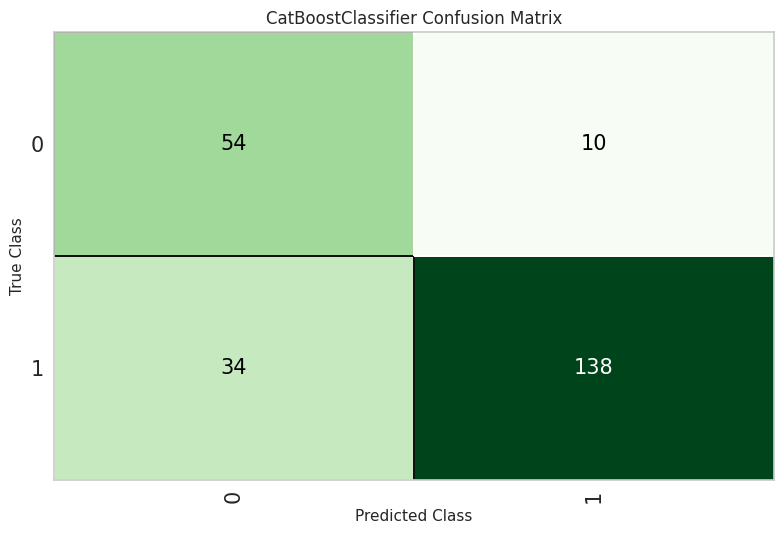

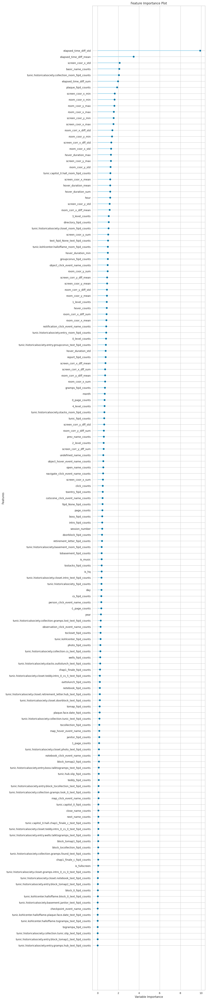

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


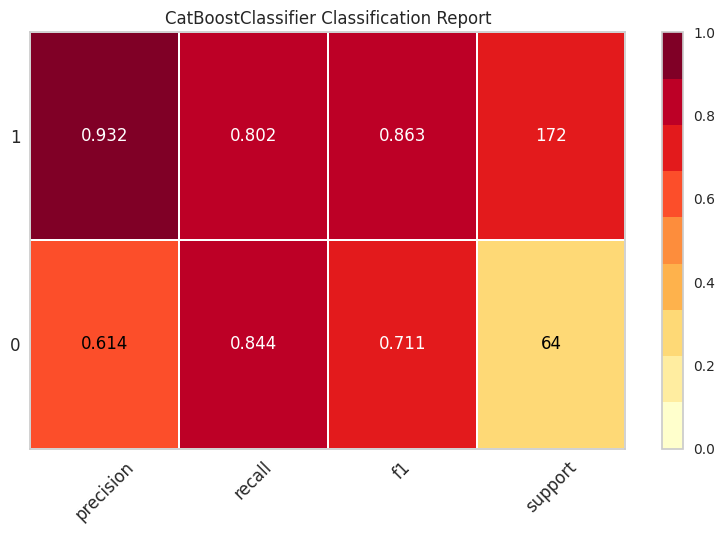

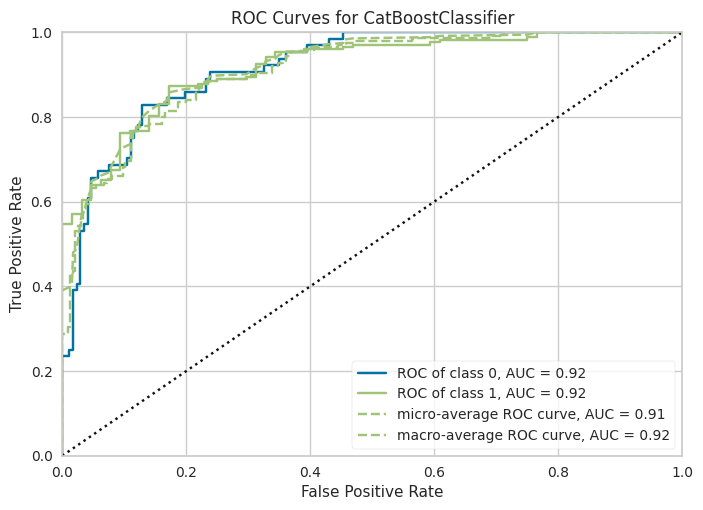

In [6]:
trail(1)

--------------------------------------------------
Question 2
--------------------------------------------------
(23562, 149)


,Description,Value
0,Session id,2
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 148)"
4,Transformed data shape,"(23562, 148)"
5,Transformed train set shape,"(23326, 148)"
6,Transformed test set shape,"(236, 148)"
7,Numeric features,140
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5024
1,0.5116
2,0.5024
3,0.4940
4,0.5191
Mean,0.5059
Std,0.0086


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5347
1,0.5351
2,0.5298
3,0.5185
4,0.5222
Mean,0.5280
Std,0.0067


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.375 with F1=0.5336


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f0e886df00>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.375,
                                     st

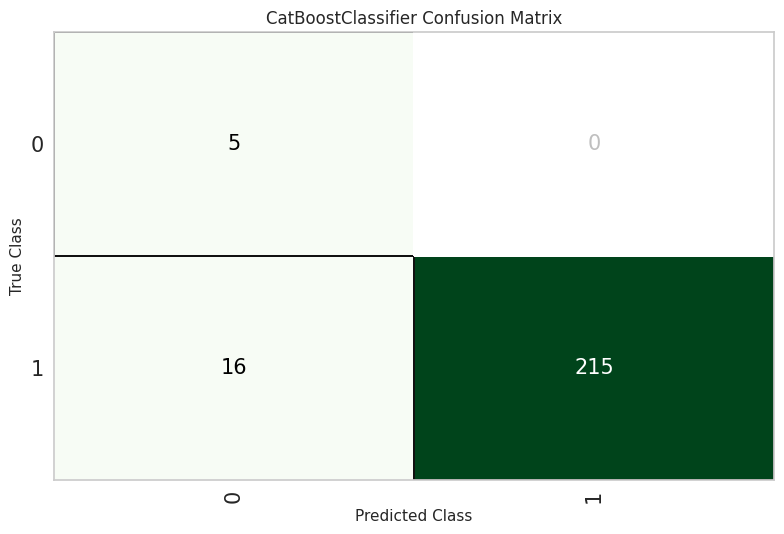

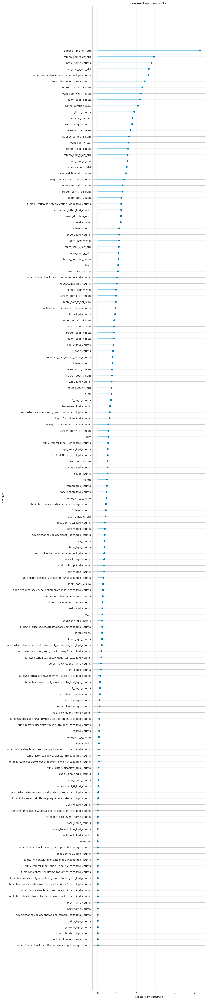

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,230
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


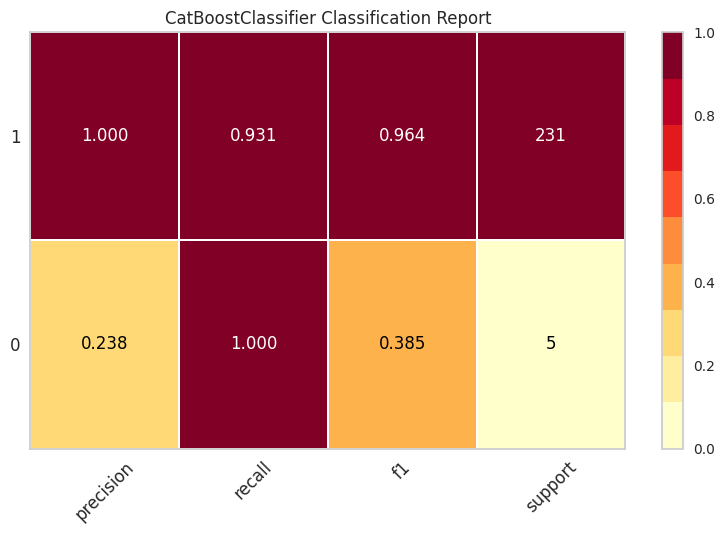

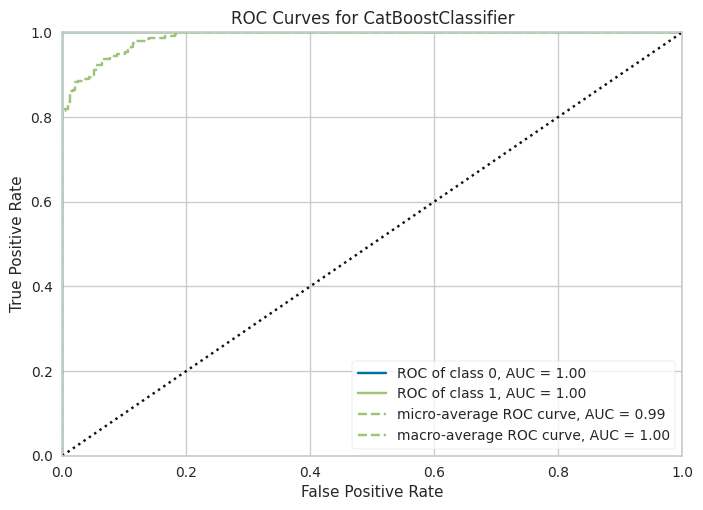

In [7]:
trail(2)

--------------------------------------------------
Question 3
--------------------------------------------------
(23562, 149)


,Description,Value
0,Session id,3
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 148)"
4,Transformed data shape,"(23562, 148)"
5,Transformed train set shape,"(23326, 148)"
6,Transformed test set shape,"(236, 148)"
7,Numeric features,140
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5500
1,0.5613
2,0.5541
3,0.5382
4,0.5719
Mean,0.5551
Std,0.0112


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5647
1,0.5558
2,0.5455
3,0.5661
4,0.5541
Mean,0.5572
Std,0.0075


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.5390625 with F1=0.56


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f03e78c3a0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.5390625,
                                   

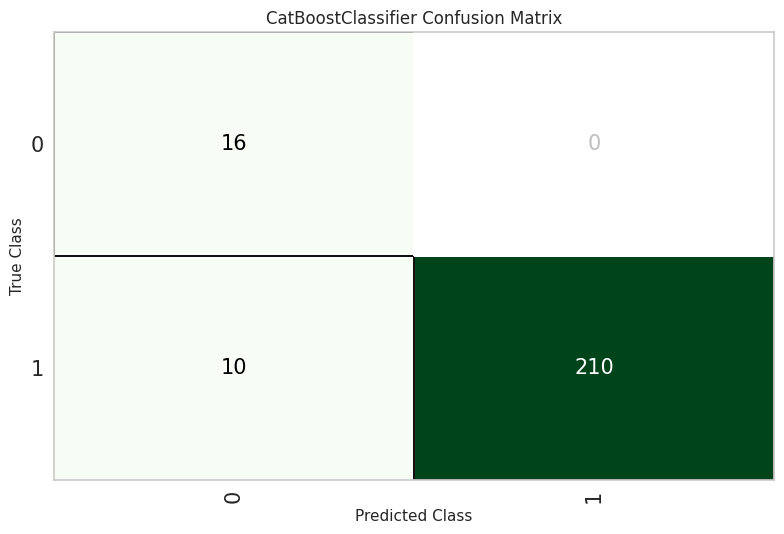

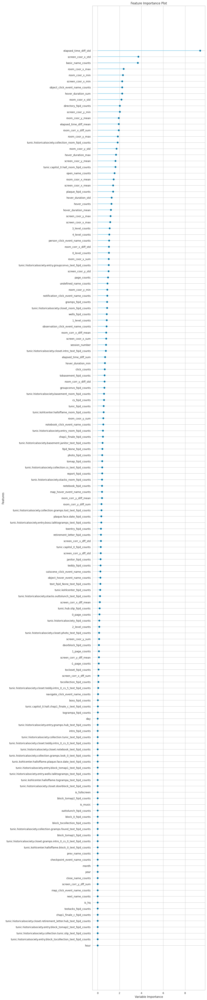

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,60
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


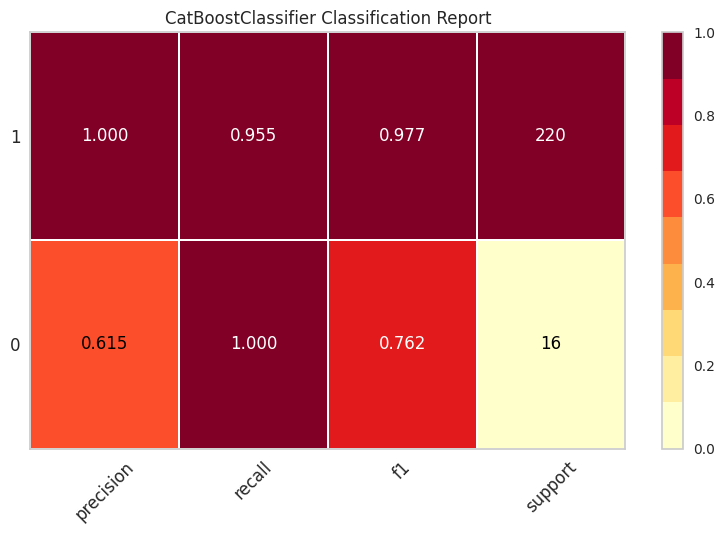

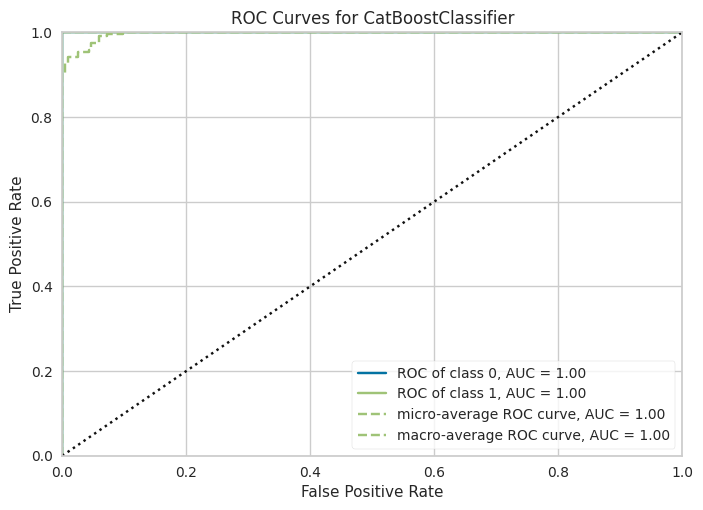

In [8]:
trail(3)

--------------------------------------------------
Question 4
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,4
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6635
1,0.6360
2,0.6539
3,0.6533
4,0.6639
Mean,0.6541
Std,0.0101


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6520
1,0.6174
2,0.6297
3,0.6514
4,0.6484
Mean,0.6398
Std,0.0139


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.4453125 with F1=0.657


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f039817f40>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4453125,
                                   

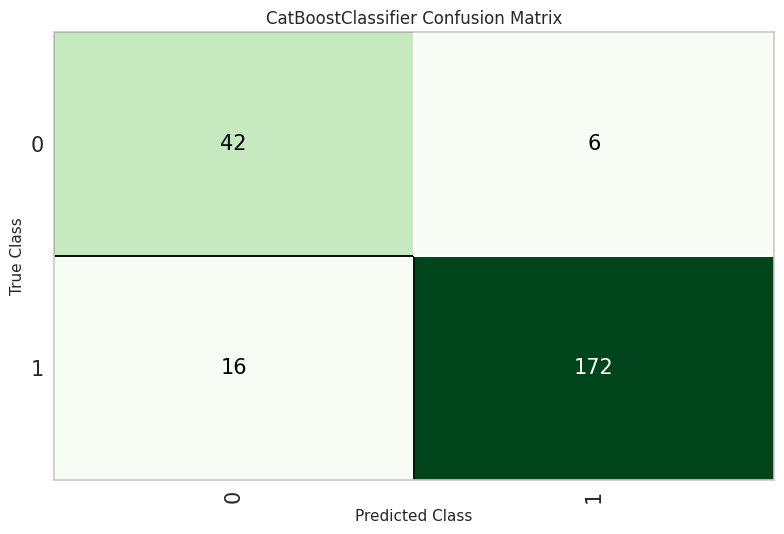

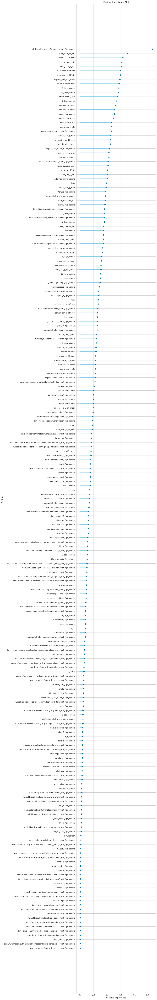

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


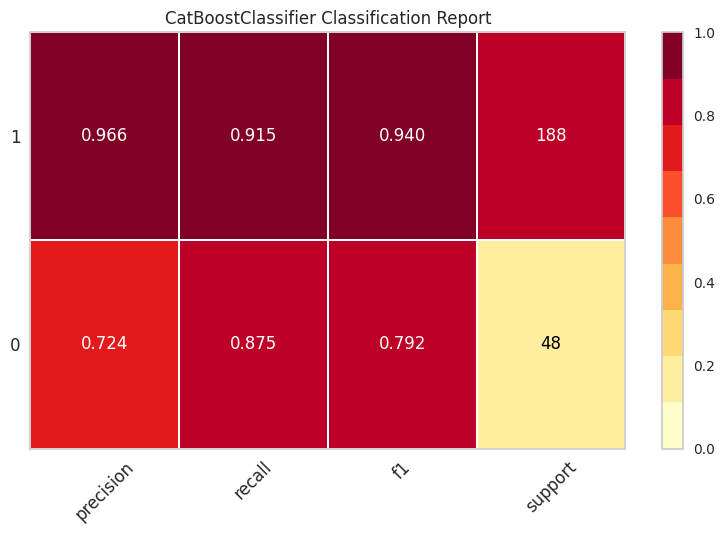

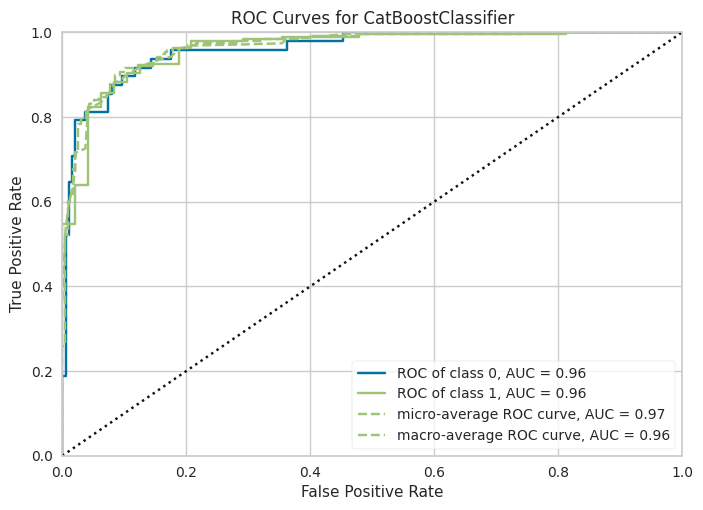

In [9]:
trail(4)

--------------------------------------------------
Question 5
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,5
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6328
1,0.6382
2,0.6341
3,0.6347
4,0.6432
Mean,0.6366
Std,0.0038


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6329
1,0.6282
2,0.6276
3,0.6387
4,0.6332
Mean,0.6321
Std,0.0040


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.4921875 with F1=0.637


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f032f059c0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4921875,
                                   

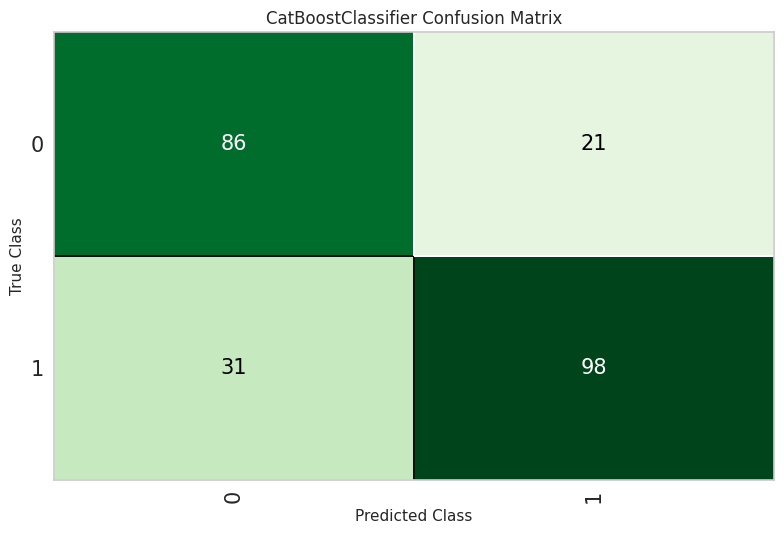

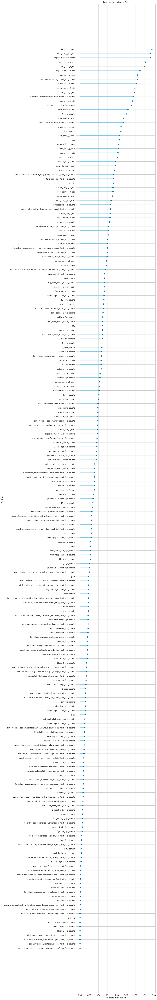

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


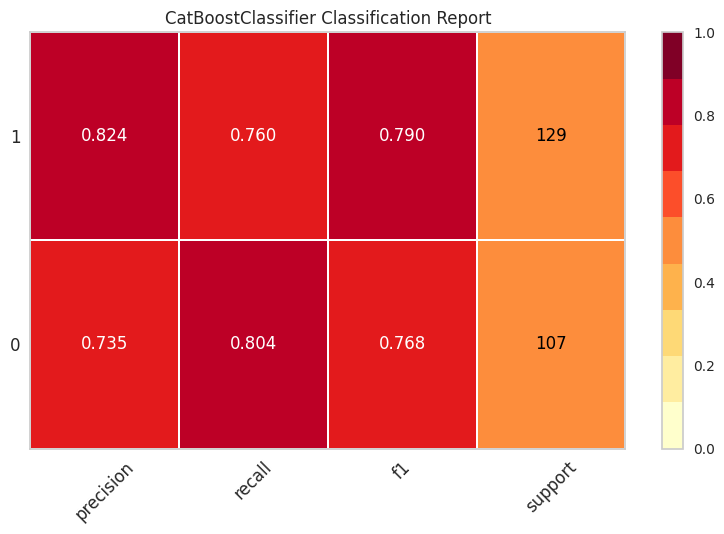

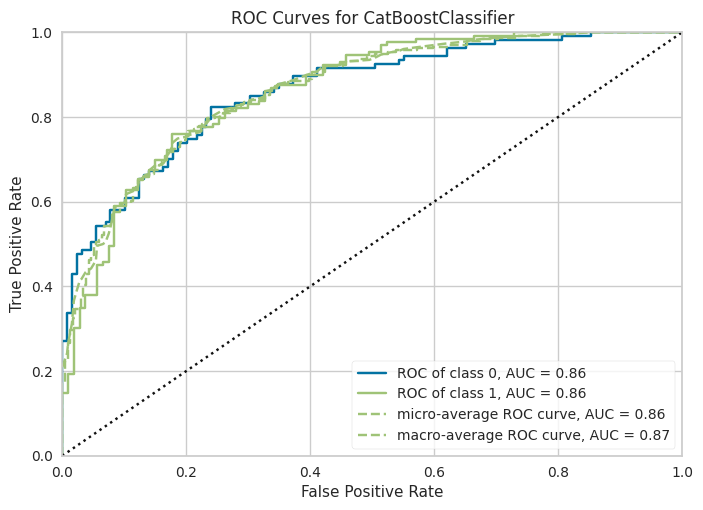

In [10]:
trail(5)

--------------------------------------------------
Question 6
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,6
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6234
1,0.6372
2,0.6317
3,0.6329
4,0.6247
Mean,0.6300
Std,0.0052


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6192
1,0.6345
2,0.6251
3,0.6240
4,0.6177
Mean,0.6241
Std,0.0059


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.453125 with F1=0.6362


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f02d93e7d0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.453125,
                                    

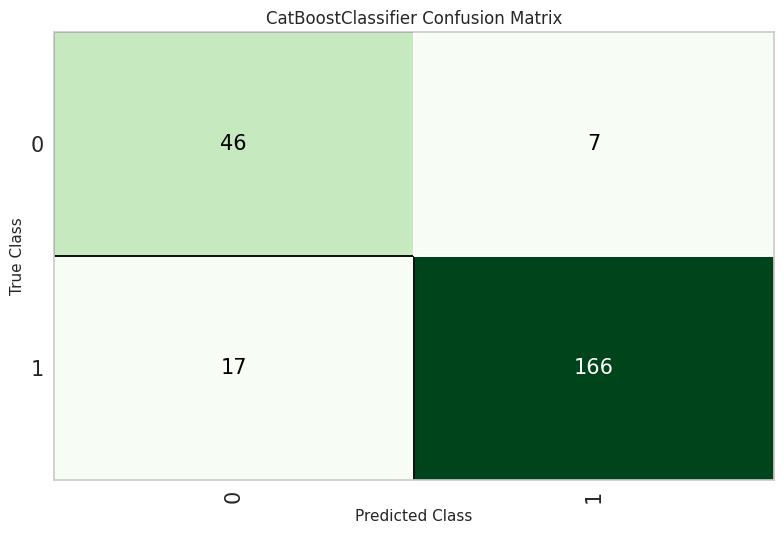

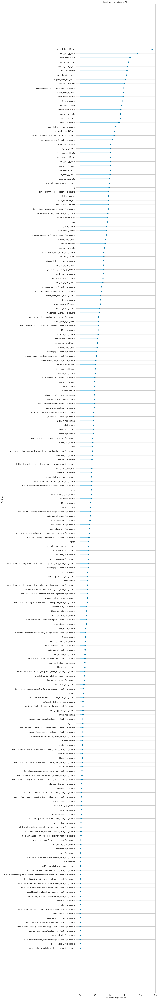

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


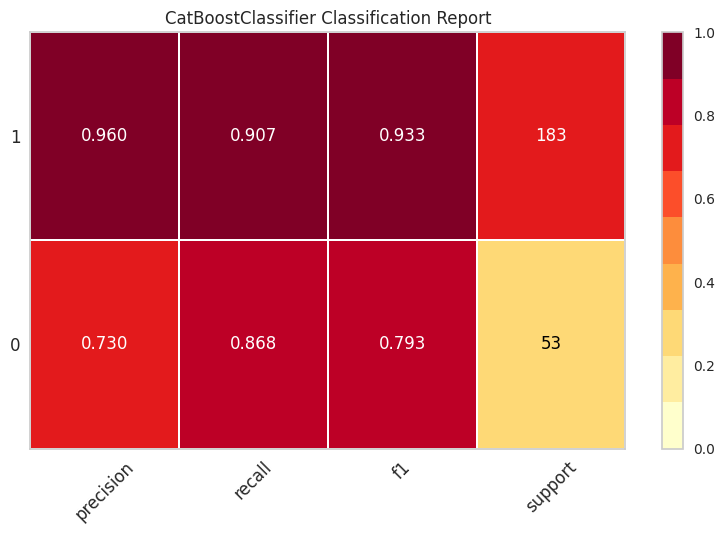

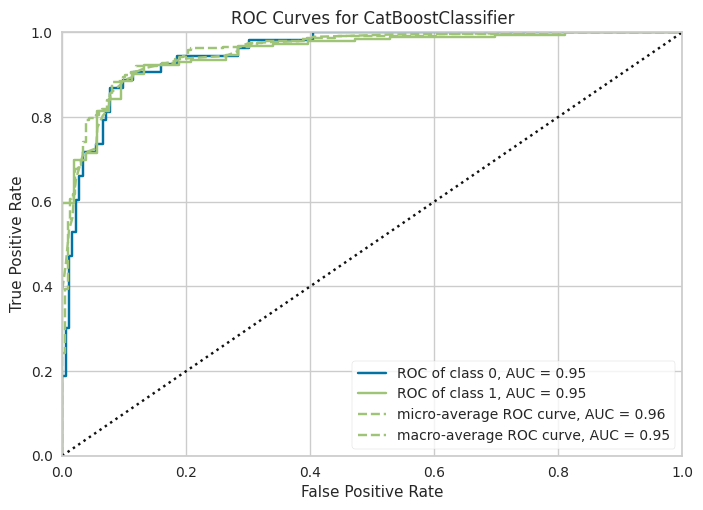

In [11]:
trail(6)

--------------------------------------------------
Question 7
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,7
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6192
1,0.6041
2,0.6175
3,0.6140
4,0.6082
Mean,0.6126
Std,0.0057


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6055
1,0.5931
2,0.6141
3,0.6013
4,0.5926
Mean,0.6013
Std,0.0081


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.4765625 with F1=0.6143


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f0270c9570>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4765625,
                                   

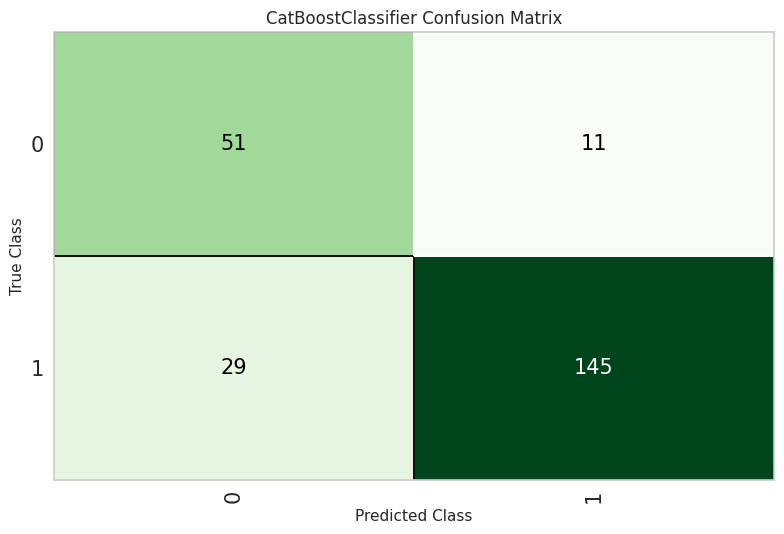

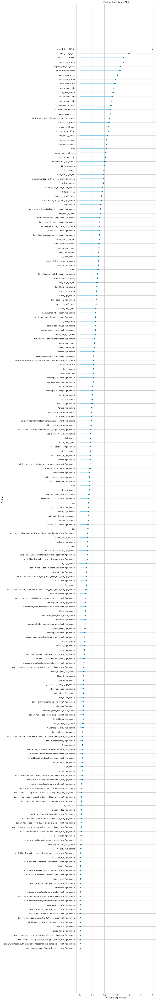

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


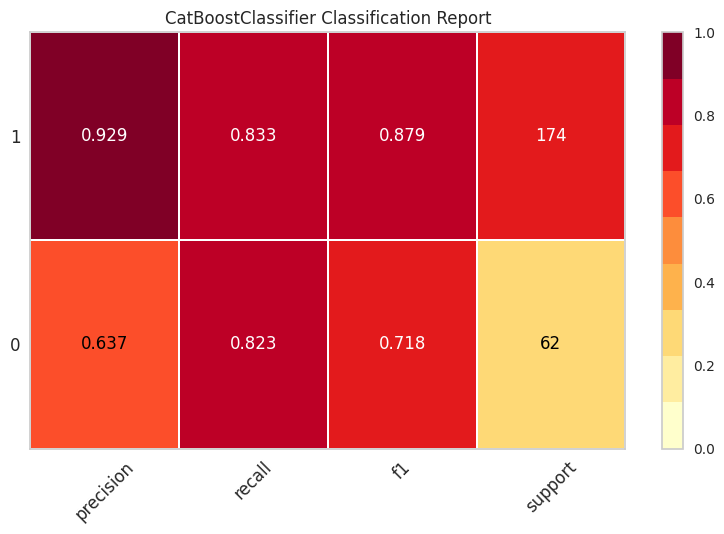

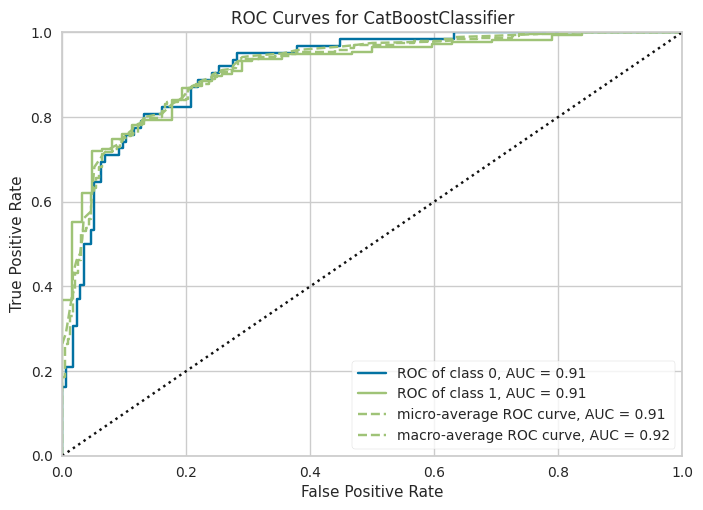

In [12]:
trail(7)

--------------------------------------------------
Question 8
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,8
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5560
1,0.5630
2,0.5599
3,0.5527
4,0.5516
Mean,0.5566
Std,0.0043


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5594
1,0.5732
2,0.5508
3,0.5452
4,0.5580
Mean,0.5573
Std,0.0094


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.4765625 with F1=0.5619


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f020688f10>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4765625,
                                   

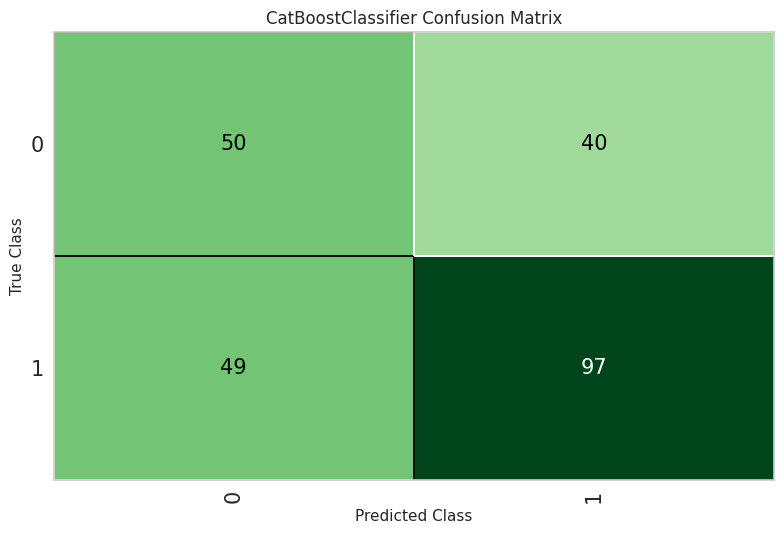

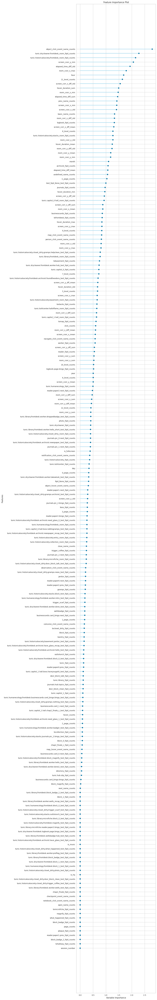

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,240
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


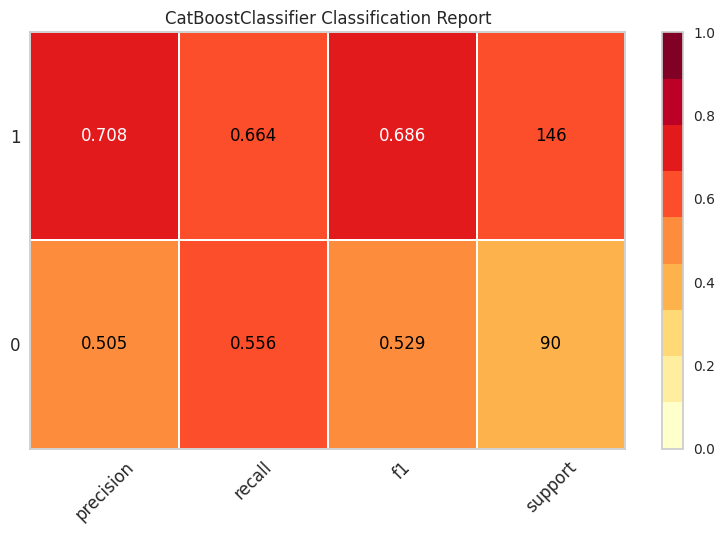

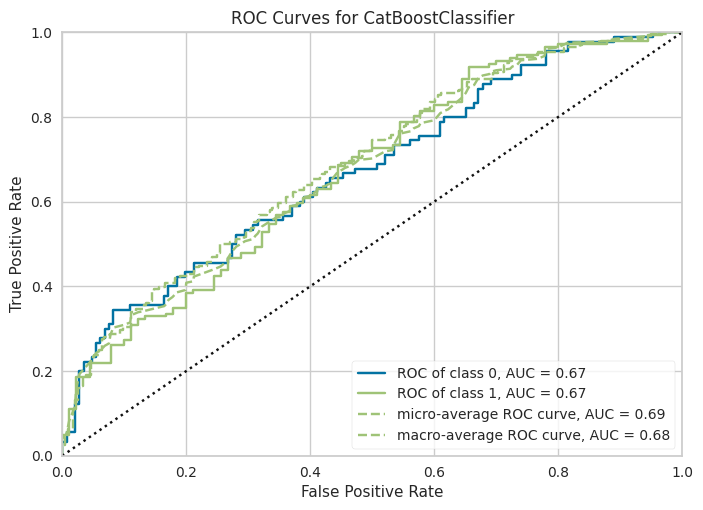

In [13]:
trail(8)

--------------------------------------------------
Question 9
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,9
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6213
1,0.6144
2,0.6191
3,0.6196
4,0.6172
Mean,0.6183
Std,0.0024


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6112
1,0.6045
2,0.6171
3,0.6132
4,0.6129
Mean,0.6118
Std,0.0041


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.4453125 with F1=0.6239


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f01cfd4d90>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4453125,
                                   

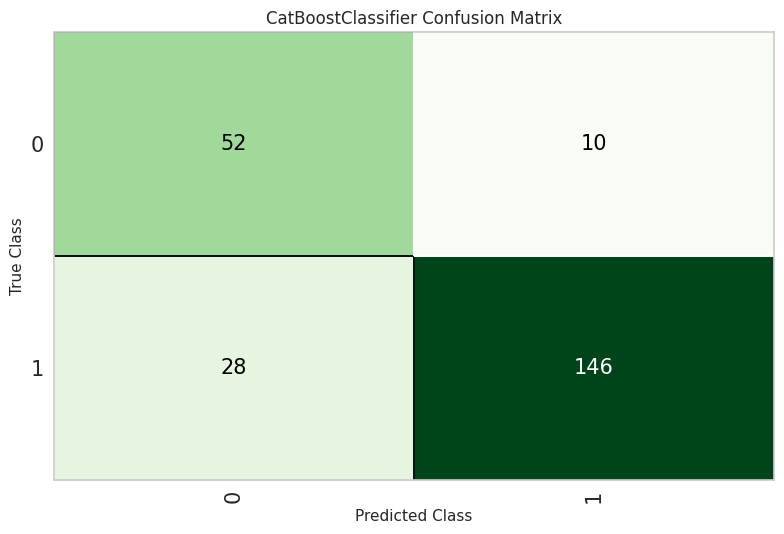

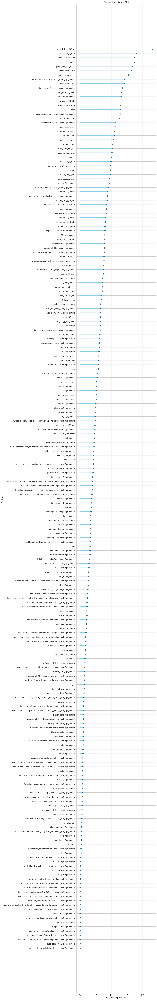

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


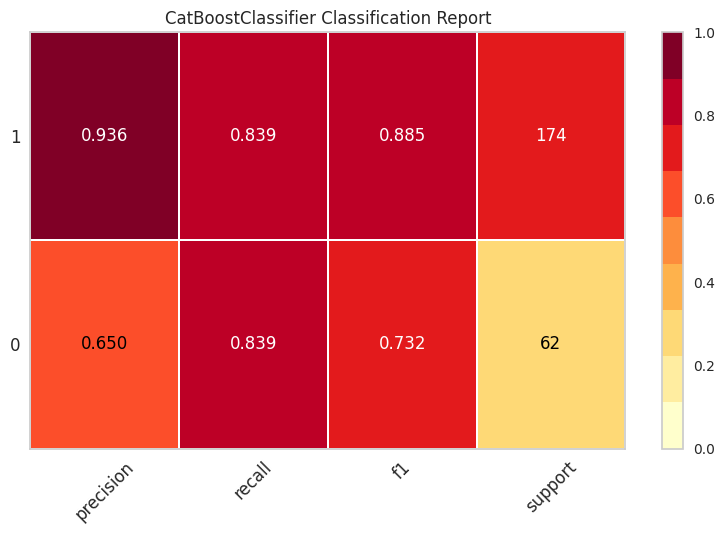

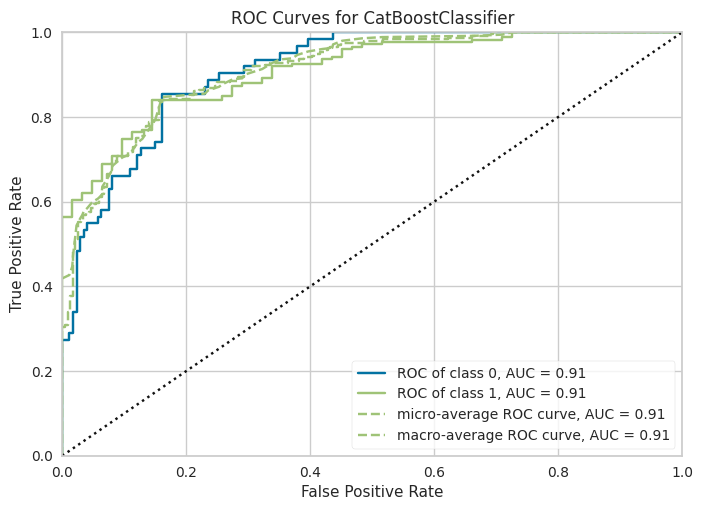

In [14]:
trail(9)

--------------------------------------------------
Question 10
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,10
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6136
1,0.6219
2,0.6265
3,0.6102
4,0.6086
Mean,0.6162
Std,0.0069


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6052
1,0.6207
2,0.6251
3,0.6047
4,0.6059
Mean,0.6123
Std,0.0088


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.515625 with F1=0.6167


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f016871ea0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.515625,
                                    

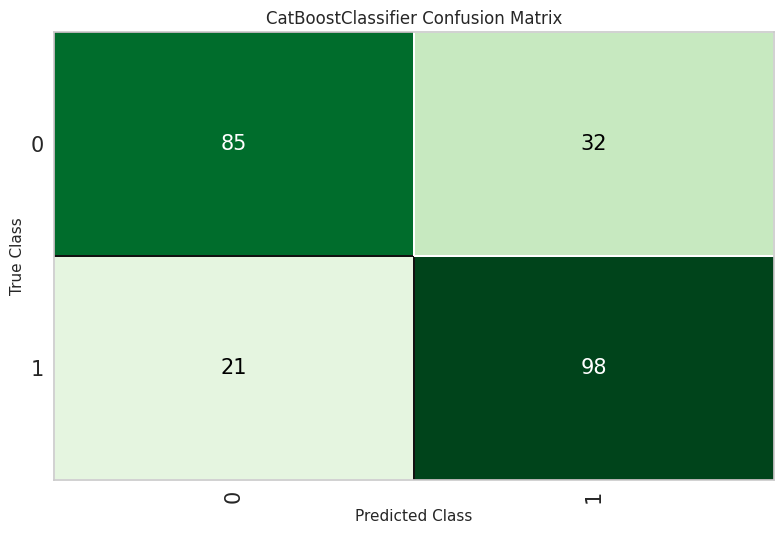

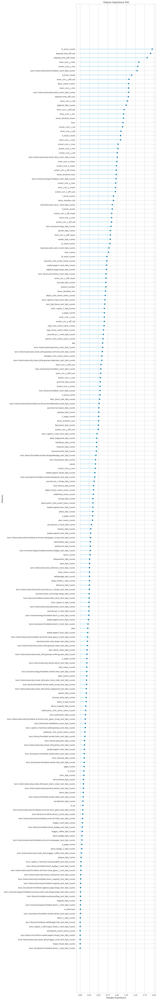

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


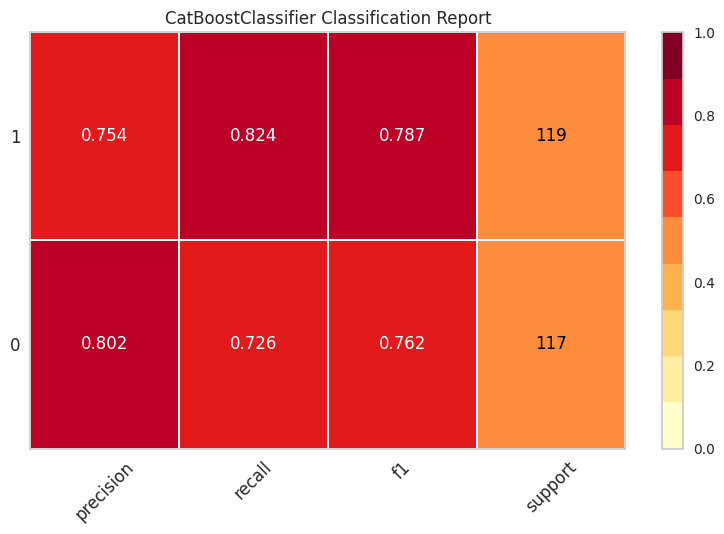

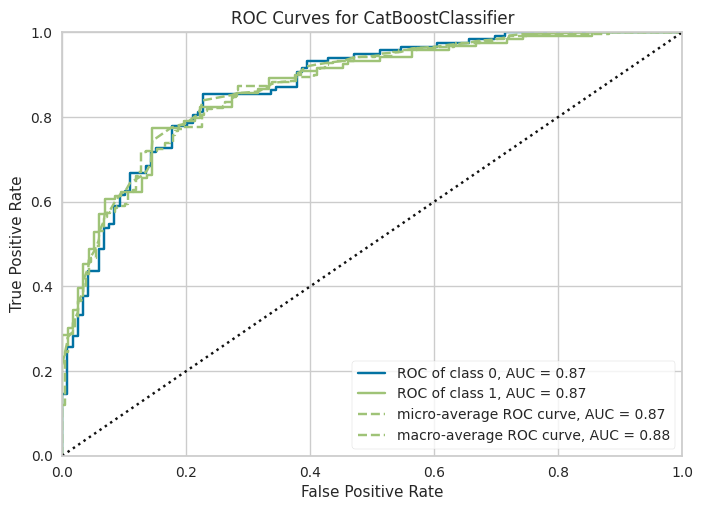

In [15]:
trail(10)

--------------------------------------------------
Question 11
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,11
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5976
1,0.6012
2,0.5908
3,0.5967
4,0.5912
Mean,0.5955
Std,0.0040


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5853
1,0.5936
2,0.5874
3,0.5921
4,0.5872
Mean,0.5891
Std,0.0032


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.4921875 with F1=0.5969


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f01127fa90>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4921875,
                                   

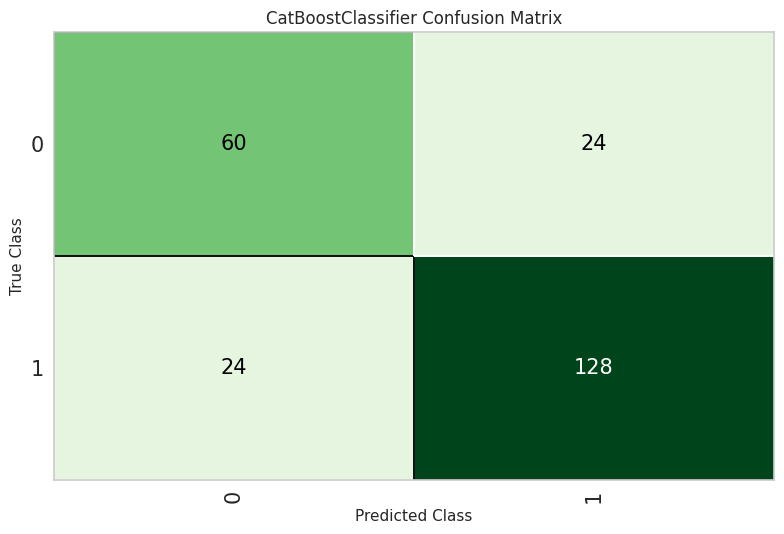

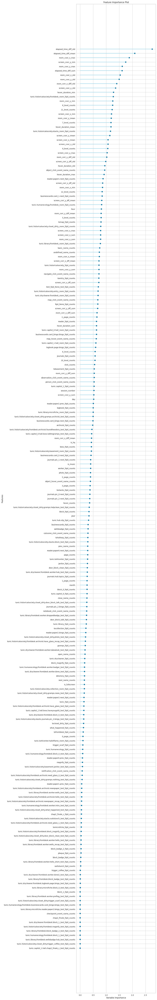

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


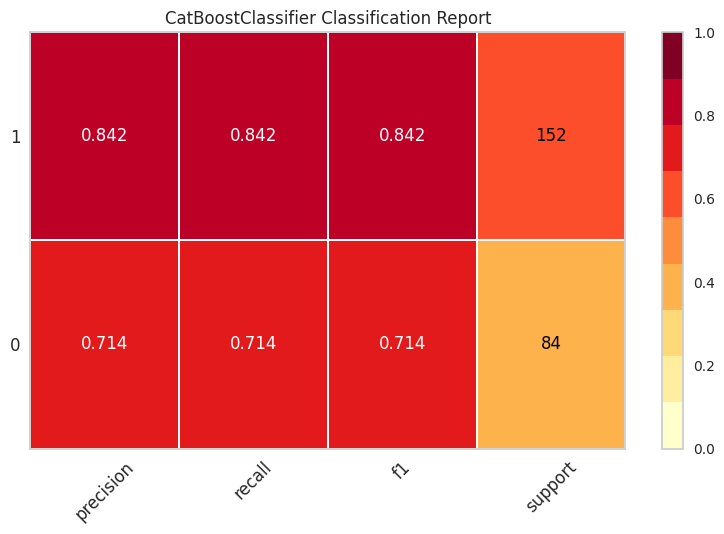

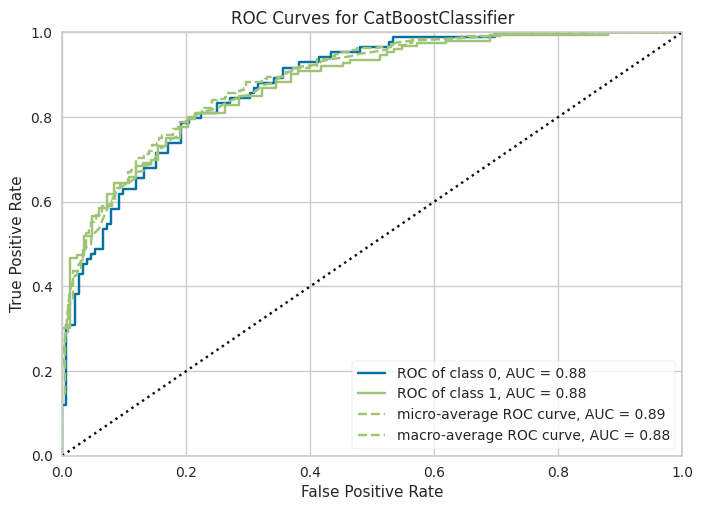

In [16]:
trail(11)

--------------------------------------------------
Question 12
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,12
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5507
1,0.5678
2,0.5680
3,0.5723
4,0.5720
Mean,0.5662
Std,0.0080


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5672
1,0.5731
2,0.5596
3,0.5649
4,0.5736
Mean,0.5677
Std,0.0052


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.4609375 with F1=0.5767


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f00be8ac20>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4609375,
                                   

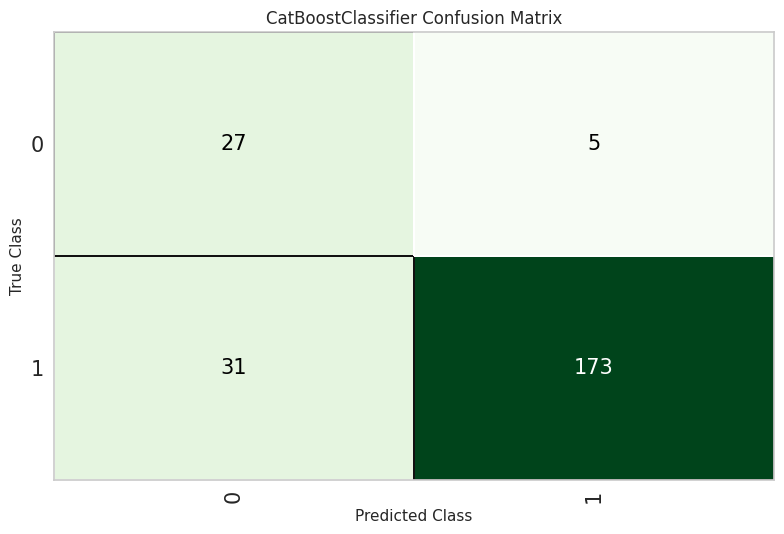

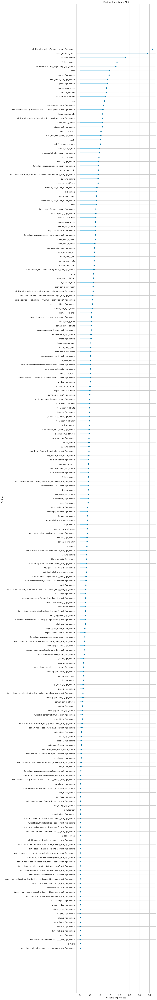

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,290
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


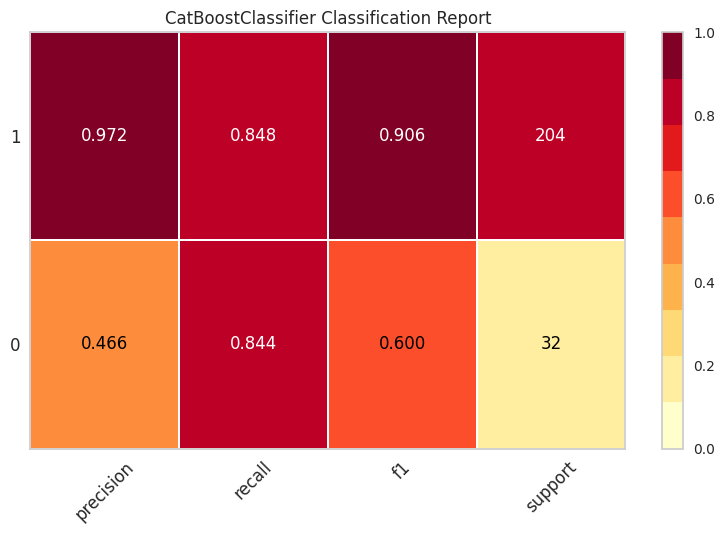

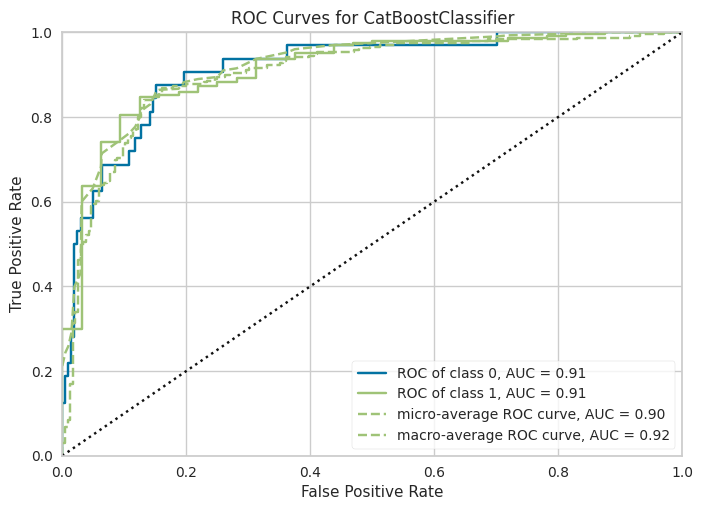

In [17]:
trail(12)

--------------------------------------------------
Question 13
--------------------------------------------------
(23562, 211)


,Description,Value
0,Session id,13
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 210)"
4,Transformed data shape,"(23562, 210)"
5,Transformed train set shape,"(23326, 210)"
6,Transformed test set shape,"(236, 210)"
7,Numeric features,202
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6108
1,0.6161
2,0.6302
3,0.6129
4,0.6112
Mean,0.6162
Std,0.0072


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6046
1,0.6090
2,0.6184
3,0.6022
4,0.6037
Mean,0.6076
Std,0.0059


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.5546875 with F1=0.6213


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f006bd8850>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.5546875,
                                   

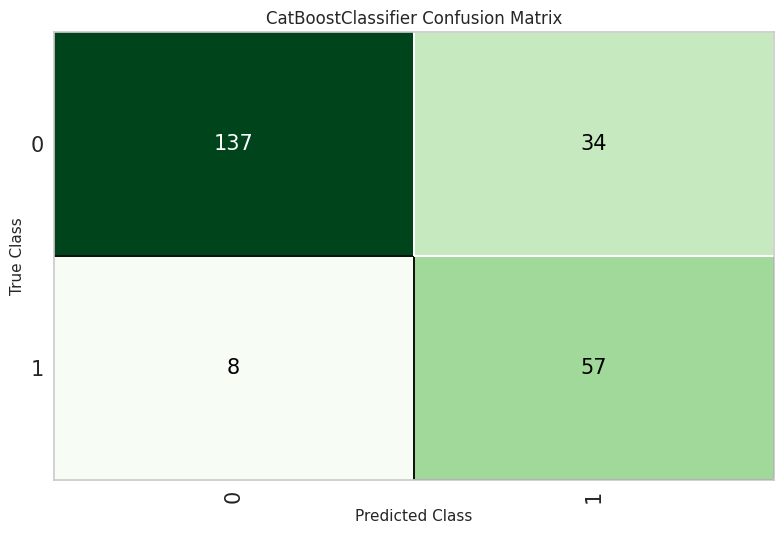

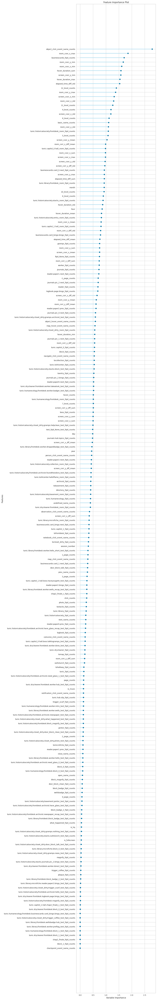

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


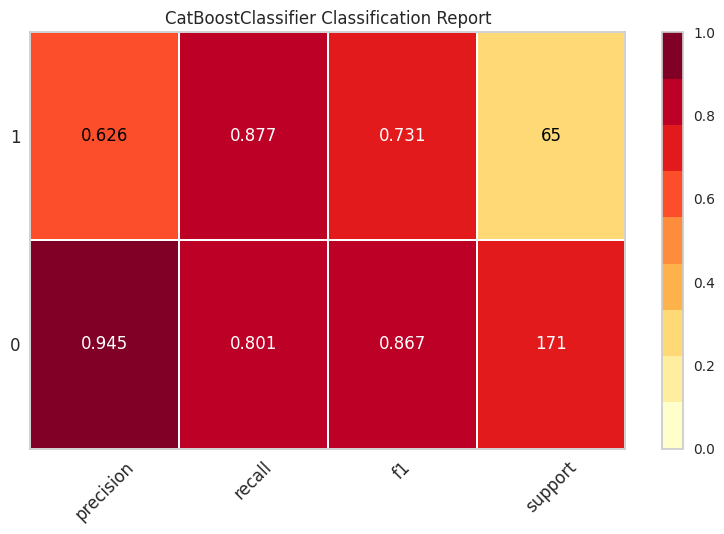

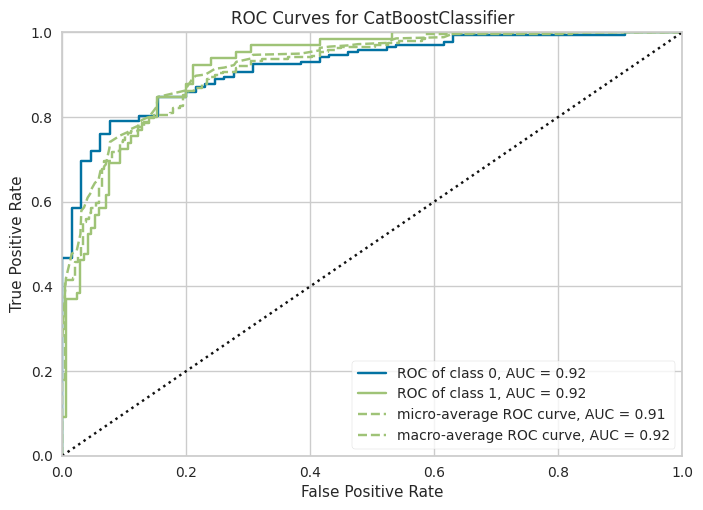

In [18]:
trail(13)

--------------------------------------------------
Question 14
--------------------------------------------------
(23562, 256)


,Description,Value
0,Session id,14
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 255)"
4,Transformed data shape,"(23562, 255)"
5,Transformed train set shape,"(23326, 255)"
6,Transformed test set shape,"(236, 255)"
7,Numeric features,247
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6380
1,0.6261
2,0.6197
3,0.6325
4,0.6189
Mean,0.6270
Std,0.0074


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6221
1,0.6263
2,0.6153
3,0.6387
4,0.6156
Mean,0.6236
Std,0.0086


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.484375 with F1=0.629


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78f026e2c610>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.484375,
                                    

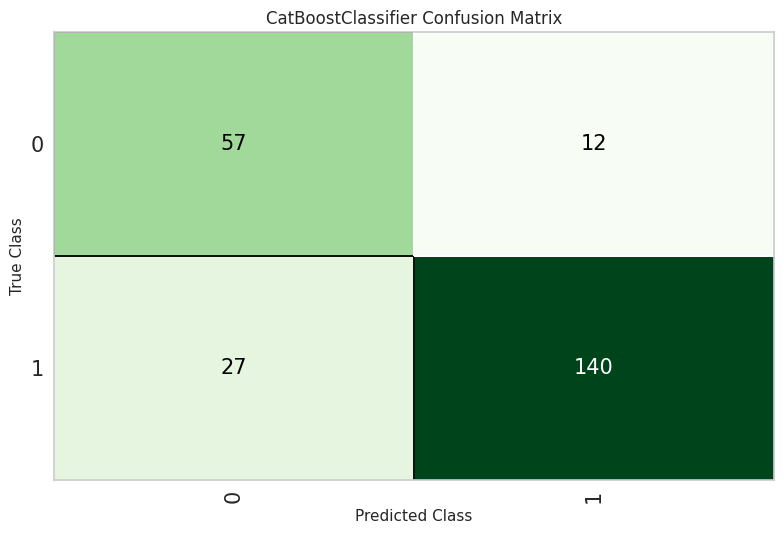

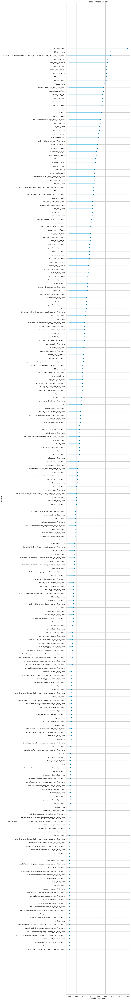

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


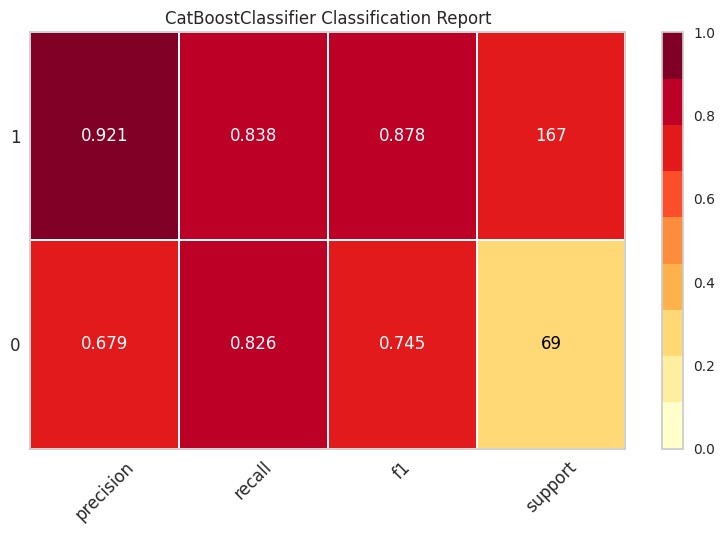

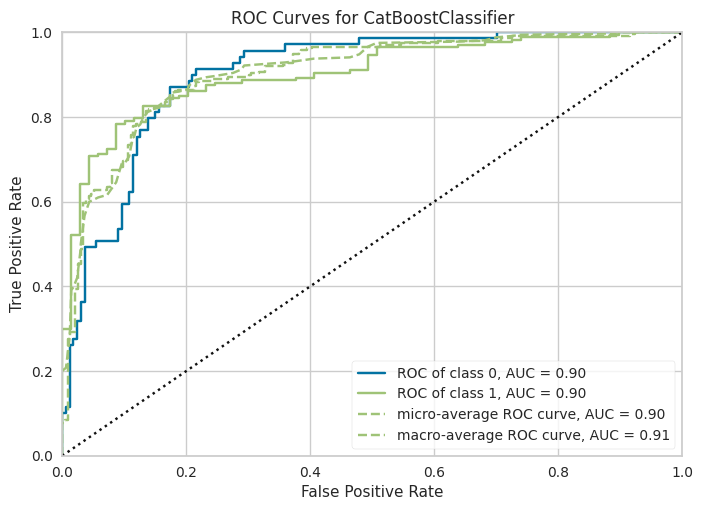

In [19]:
trail(14)

--------------------------------------------------
Question 15
--------------------------------------------------
(23562, 256)


,Description,Value
0,Session id,15
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 255)"
4,Transformed data shape,"(23562, 255)"
5,Transformed train set shape,"(23326, 255)"
6,Transformed test set shape,"(236, 255)"
7,Numeric features,247
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.6361
1,0.6322
2,0.6398
3,0.6357
4,0.6316
Mean,0.6351
Std,0.0030


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.6339
1,0.6355
2,0.6427
3,0.6276
4,0.6299
Mean,0.6339
Std,0.0052


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.5 with F1=0.6351


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78eff7af74c0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.5,
                                     step

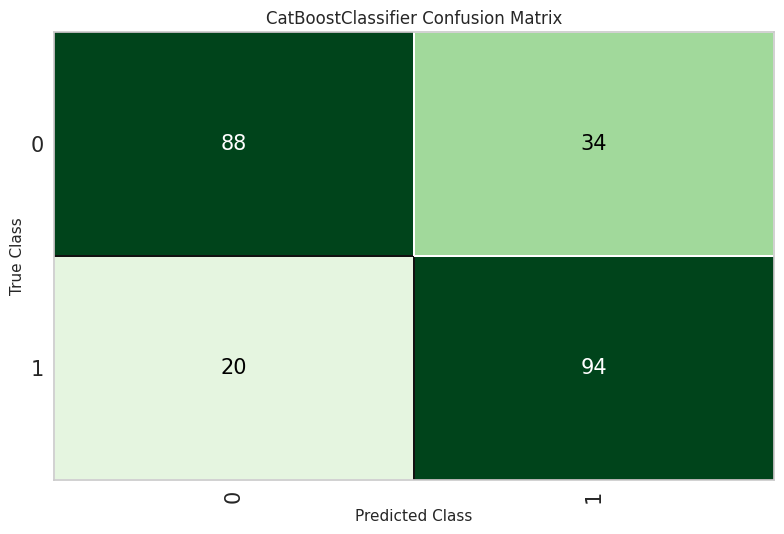

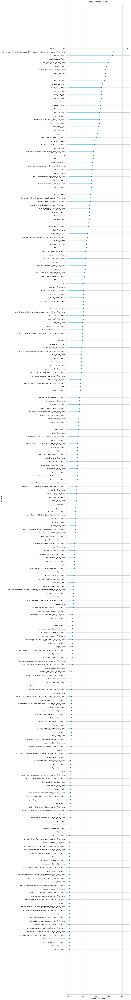

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


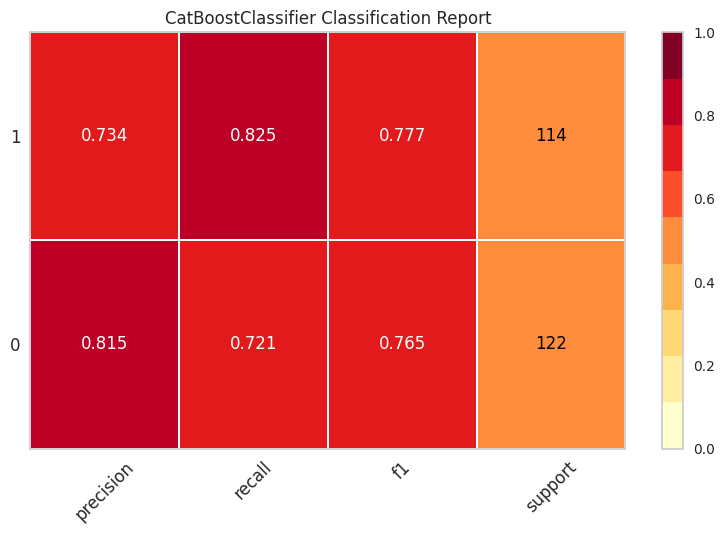

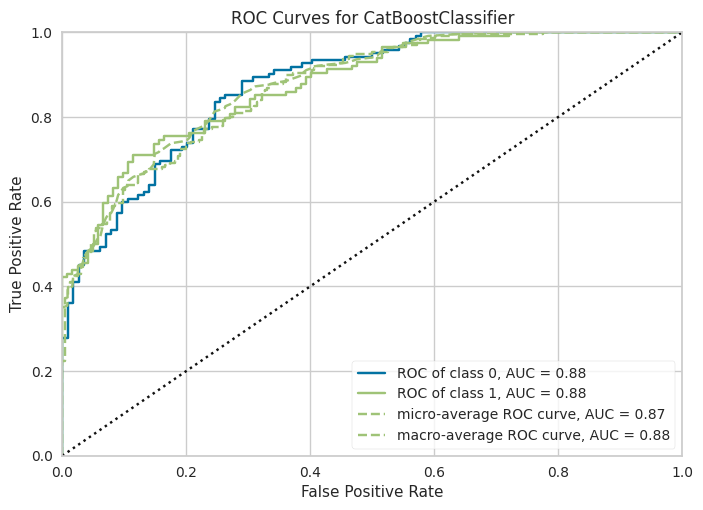

In [20]:
trail(15)

--------------------------------------------------
Question 16
--------------------------------------------------
(23562, 256)


,Description,Value
0,Session id,16
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 255)"
4,Transformed data shape,"(23562, 255)"
5,Transformed train set shape,"(23326, 255)"
6,Transformed test set shape,"(236, 255)"
7,Numeric features,247
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5320
1,0.5328
2,0.5363
3,0.5326
4,0.5314
Mean,0.5330
Std,0.0017


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5483
1,0.5410
2,0.5413
3,0.5339
4,0.5351
Mean,0.5399
Std,0.0052


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.500463520530565 with F1=0.2095


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78eff13c3970>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.500463520530565,
                           

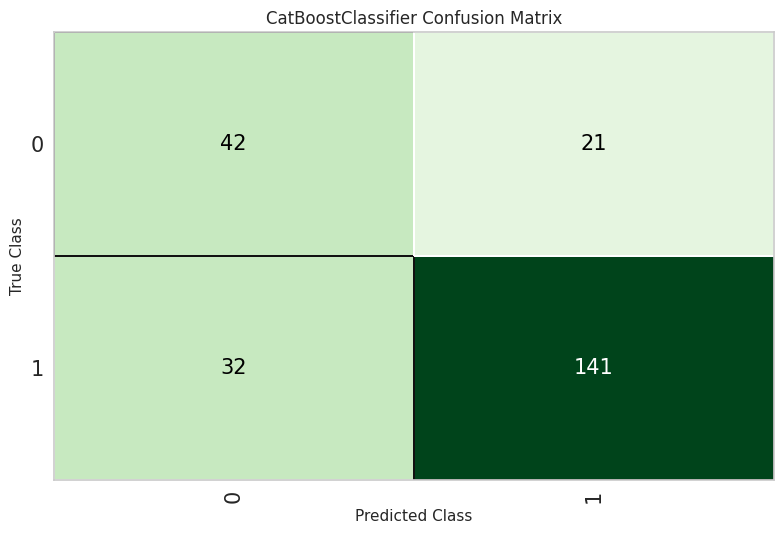

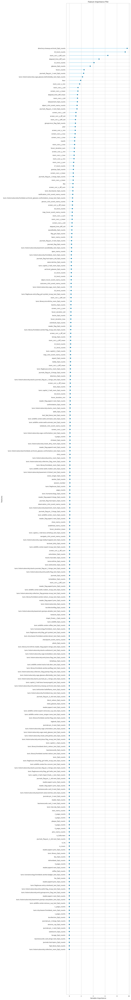

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,250
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


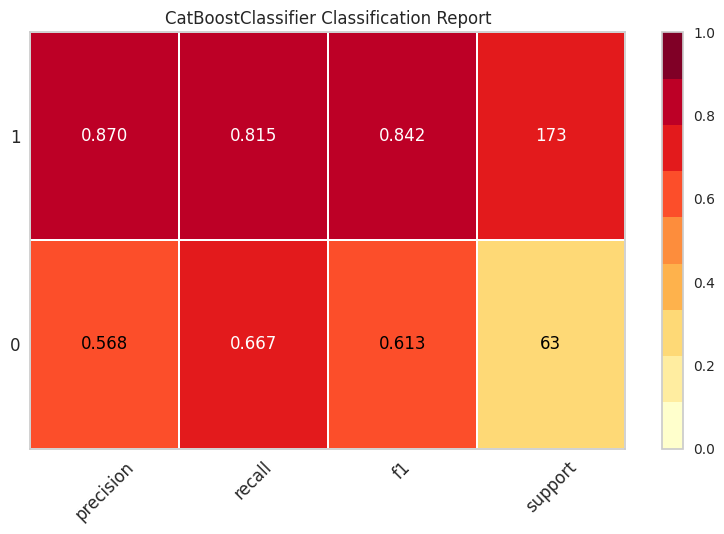

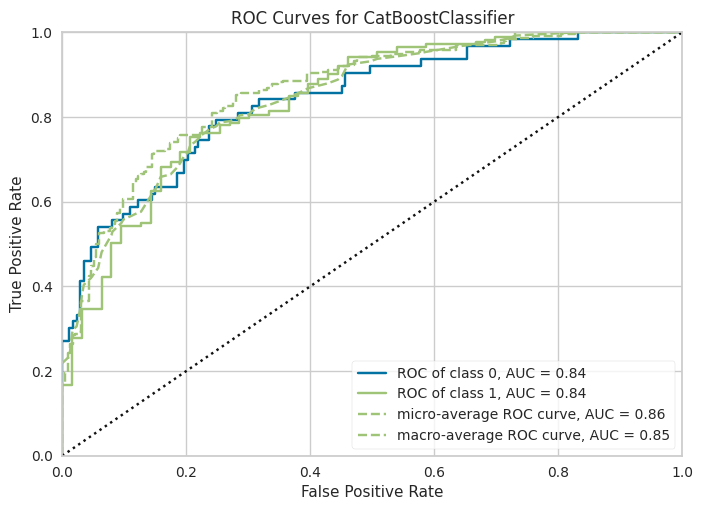

In [21]:
trail(16)

--------------------------------------------------
Question 17
--------------------------------------------------
(23562, 256)


,Description,Value
0,Session id,17
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 255)"
4,Transformed data shape,"(23562, 255)"
5,Transformed train set shape,"(23326, 255)"
6,Transformed test set shape,"(236, 255)"
7,Numeric features,247
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5462
1,0.5484
2,0.5430
3,0.5315
4,0.5522
Mean,0.5443
Std,0.0071


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5383
1,0.5407
2,0.5246
3,0.5297
4,0.5482
Mean,0.5363
Std,0.0083


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.23.5
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
optimization loop finished successfully. Best threshold: 0.484375 with F1=0.5458


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78efea8716f0>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.484375,
                                    

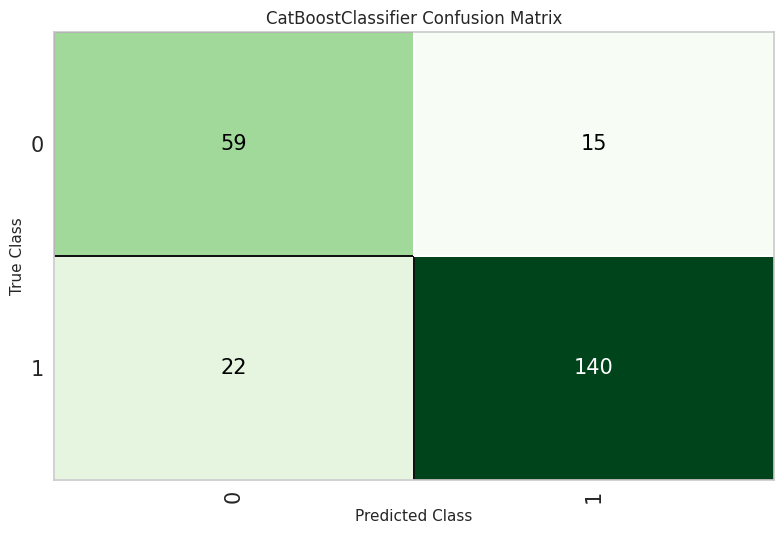

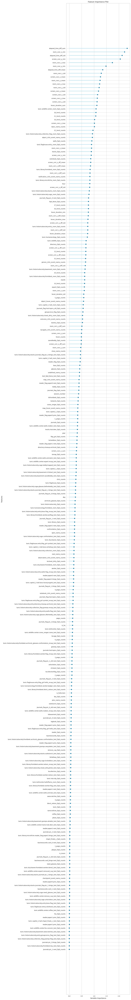

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,1000
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


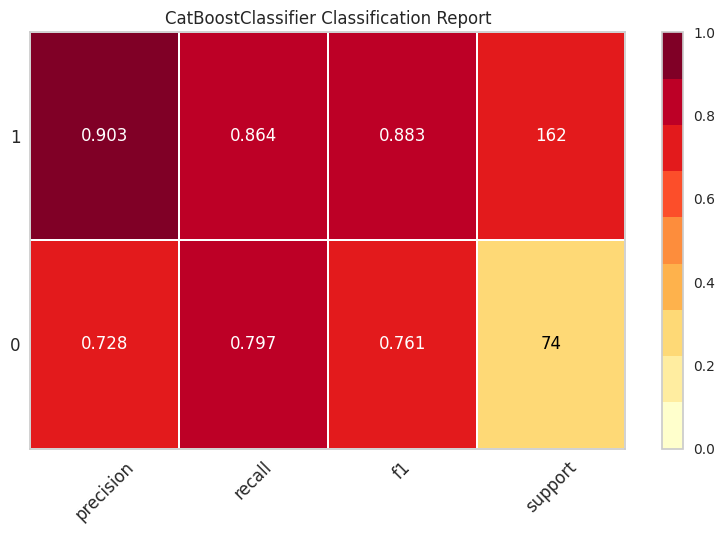

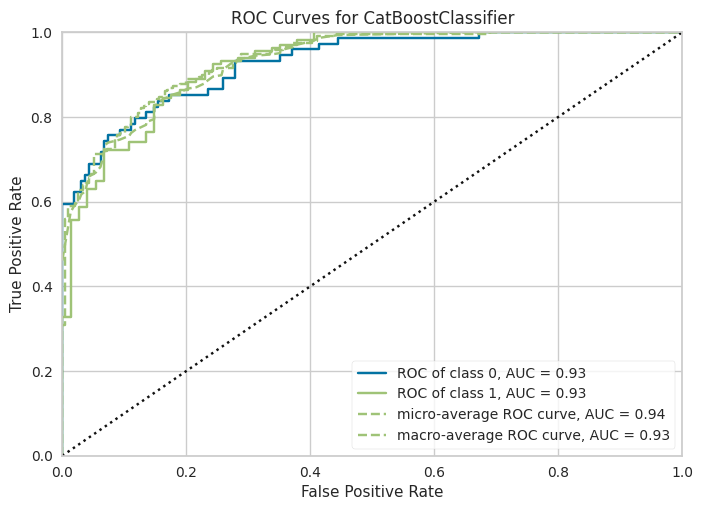

In [22]:
trail(17)

--------------------------------------------------
Question 18
--------------------------------------------------
(23562, 256)


,Description,Value
0,Session id,18
1,Target,target
2,Target type,Binary
3,Original data shape,"(23562, 255)"
4,Transformed data shape,"(23562, 255)"
5,Transformed train set shape,"(23326, 255)"
6,Transformed test set shape,"(236, 255)"
7,Numeric features,247
8,Categorical features,7
9,Rows with missing values,7.9%


,F1
Fold,
0,0.5457
1,0.5443
2,0.5371
3,0.5471
4,0.5456
Mean,0.5440
Std,0.0035


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,F1
Fold,
0,0.5710
1,0.5631
2,0.5549
3,0.5683
4,0.5624
Mean,0.5639
Std,0.0055


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

optimization loop finished successfully. Best threshold: 0.4765625 with F1=0.567


CustomProbabilityThresholdClassifier(classifier=Pipeline(memory=FastMemory(location=/tmp/joblib),
                                                         steps=[('clean_column_names',
                                                                 TransformerWrapper(exclude=None,
                                                                                    include=None,
                                                                                    transformer=CleanColumnNames(match='[\\]\\[\\,\\{\\}\\"\\:]+'))),
                                                                ('actual_estimator',
                                                                 <catboost.core.CatBoostClassifier object at 0x78efe4ddc820>)],
                                                         verbose=False),
                                     memory=FastMemory(location=/tmp/joblib),
                                     probability_threshold=0.4765625,
                                   

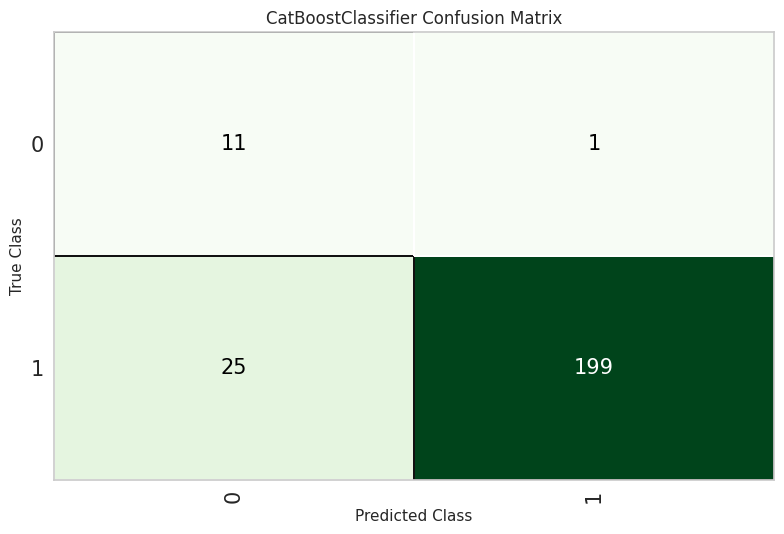

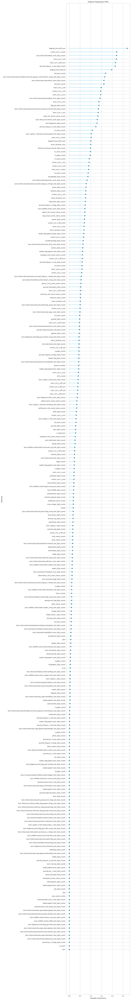

,Parameters
nan_mode,Min
eval_metric,Logloss
combinations_ctr,['Borders:CtrBorderCount=15:CtrBorderType=Unif...
iterations,220
sampling_frequency,PerTree
fold_permutation_block,0
leaf_estimation_method,Newton
counter_calc_method,SkipTest
grow_policy,SymmetricTree
penalties_coefficient,1


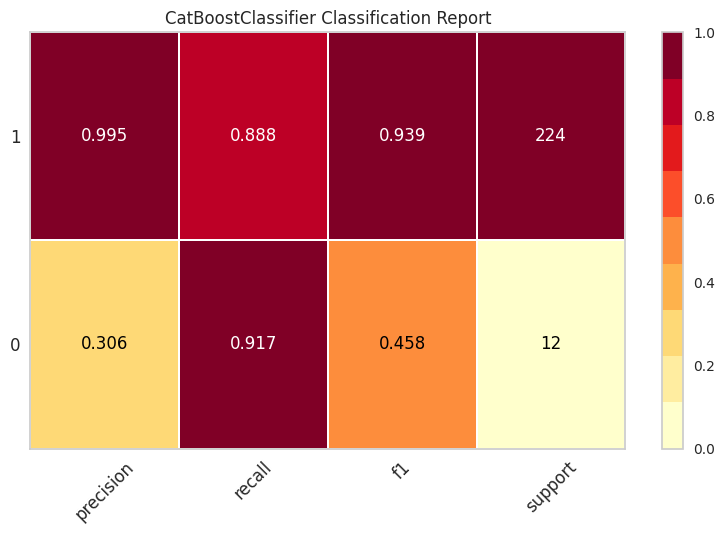

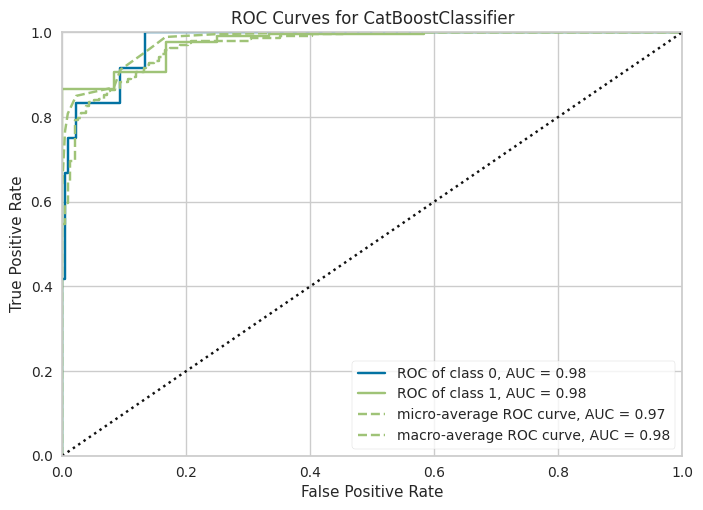

In [23]:
trail(18)